In [2]:
# Se cargan las librerías
from pandas import DataFrame
from pandas import concat
import random
from scipy import stats
import numpy as np
import pandas as pd
from math import sqrt
from numpy import concatenate
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
from pandas import DataFrame
from pandas import concat
import seaborn as sn
import matplotlib as mpl
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import gc
from IPython.display import YouTubeVideo
import statsmodels.api as sm
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller
from pmdarima.arima import auto_arima
#from darts import TimeSeries
import pmdarima as pm
#from darts.models import (NaiveSeasonal,NaiveDrift,RNNModel,Prophet,ExponentialSmoothing,ARIMA,AutoARIMA,TCNModel,TransformerModel,Theta,FFT)
import warnings
warnings.filterwarnings('ignore')


In [4]:
local='Datos históricos Bitcoin 2013.csv'
btc_ts = pd.read_csv(local,  parse_dates=['Fecha'], index_col='Fecha')
btc_ts.rename(columns={'Último': 'Precio'}, inplace=True)
#btc_ts=btc_ts.rename({'Fecha': 'ds', 'Precio': 'y'}, axis='columns')
columns_to_drop = ['Apertura','Máximo','Mínimo','Vol.','% var.']
btc_ts.drop(columns=columns_to_drop, inplace=True)
btc_ts['Precio'] = btc_ts['Precio'].str.replace('.', '', regex=False).str.replace(',', '.', regex=False).astype(float)
btc_ts.head()


,Precio
Fecha,
2023-10-24,34106.1
2023-10-23,33041.8
2023-10-22,29984.2
2023-10-21,29912.9
2023-10-20,29674.5


In [5]:
#local1='C:/Users/Hernán Ifrán/Downloads/Datos históricos CBOE Volatility Index.csv'
local1='Datos históricos CBOE Volatility Index.csv'
vix_ts = pd.read_csv(local1,  parse_dates=['Fecha'], index_col='Fecha')
vix_ts.rename(columns={'Último': 'Precio1'}, inplace=True)
columns_to_drop = ['Apertura','Máximo','Mínimo','Vol.','% var.']
vix_ts.drop(columns=columns_to_drop, inplace=True)
# Reemplaza los puntos por nada (eliminar los puntos) y luego reemplaza las comas por puntos decimales
vix_ts['Precio1'] = vix_ts['Precio1'].str.replace('.', '', regex=False).str.replace(',', '.', regex=False).astype(float)
vix_ts.head()

,Precio1
Fecha,
2023-10-24,18.97
2023-10-23,20.37
2023-10-20,21.71
2023-10-19,21.40
2023-10-18,19.22


In [6]:
#local2='C:/Users/Hernán Ifrán/Downloads/Datos históricos SPY (1).csv'
local2='Datos históricos SPY (1).csv'
spy_ts = pd.read_csv(local2,  parse_dates=['Fecha'], index_col='Fecha')
spy_ts.rename(columns={'Último': 'Precio2'}, inplace=True)
columns_to_drop = ['Apertura','Máximo','Mínimo','Vol.','% var.']
spy_ts.drop(columns=columns_to_drop, inplace=True)
# Reemplaza los puntos por nada (eliminar los puntos) y luego reemplaza las comas por puntos decimales
spy_ts['Precio2'] = spy_ts['Precio2'].str.replace('.', '', regex=False).str.replace(',', '.', regex=False).astype(float)
spy_ts.head()

,Precio2
Fecha,
2023-10-24,423.63
2023-10-23,420.46
2023-10-20,421.19
2023-10-19,426.43
2023-10-18,430.21


In [7]:
import pandas as pd
btc_ts=btc_ts.dropna()
vix_ts=vix_ts.dropna()
spy_ts=spy_ts.dropna()

In [8]:
# Verificamos si hay nulos
print(btc_ts.isnull().values.any())
# Verificamos si hay nulos
print(vix_ts.isnull().values.any())
# Verificamos si hay nulos
print(spy_ts.isnull().values.any())

False
False
False


<Axes: xlabel='Fecha'>

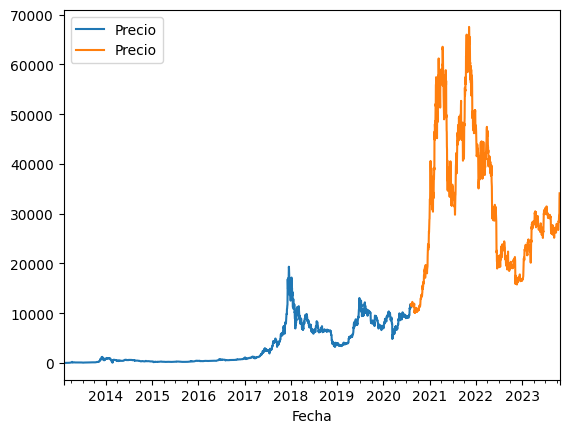

In [9]:
train = btc_ts[-int(0.7 * len(btc_ts)):]
test = btc_ts[:-int(0.7 * len(btc_ts))]

ax = train.plot()
test.plot(ax=ax)


<Axes: xlabel='Fecha'>

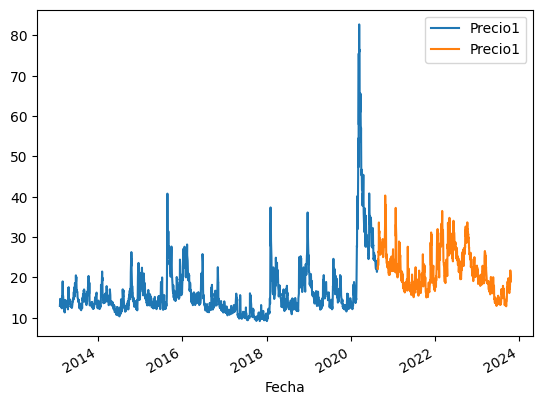

In [10]:
train1 = vix_ts[-int(0.7 * len(vix_ts)):]
test1= vix_ts[:-int(0.7 * len(vix_ts))]
ax = train1.plot()
test1.plot(ax=ax)


<Axes: xlabel='Fecha'>

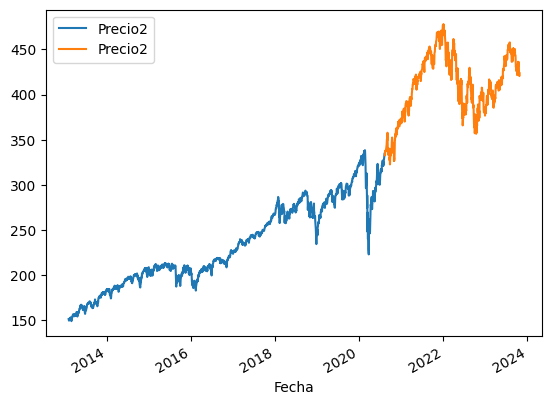

In [11]:
# Se divide en entranamiento (70%) y testeo (30%)
train2 = spy_ts[-int(0.7*len(spy_ts)):]
test2 = spy_ts[:-int(0.7*len(spy_ts))]

# Se grafican ambos conjuntos de datos
ax = train2.plot()
test2.plot(ax=ax)

In [14]:
from prophet import Prophet
from prophet.plot import add_changepoints_to_plot

In [15]:

# Inicializa el modelo Prophet
m = Prophet(interval_width=0.95)

# Restablece el índice para que Prophet pueda utilizar la fecha directamente
train_reset = train.reset_index()

# Renombra las columnas si es necesario
train_reset = train_reset.rename(columns={'Fecha': 'ds', 'Precio': 'y'})

# Ajusta el modelo con los datos de entrenamiento
m.fit(train_reset)

# Crea un DataFrame de fechas futuras para hacer predicciones
future = m.make_future_dataframe(periods=720, freq='D')

# Genera las predicciones
forecast = m.predict(future)

# Muestra las últimas filas de las predicciones, incluyendo la columna 'ds' y la columna 'yhat'
print(forecast[['ds', 'yhat']].tail())

train_reset.info()


20:00:35 - cmdstanpy - INFO - Chain [1] start processing
20:00:36 - cmdstanpy - INFO - Chain [1] done processing


             ds          yhat
3457 2022-07-21  15739.213434
3458 2022-07-22  15768.000394
3459 2022-07-23  15794.831779
3460 2022-07-24  15801.494877
3461 2022-07-25  15837.453795
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2742 entries, 0 to 2741
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      2742 non-null   datetime64[ns]
 1   y       2742 non-null   float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 43.0 KB


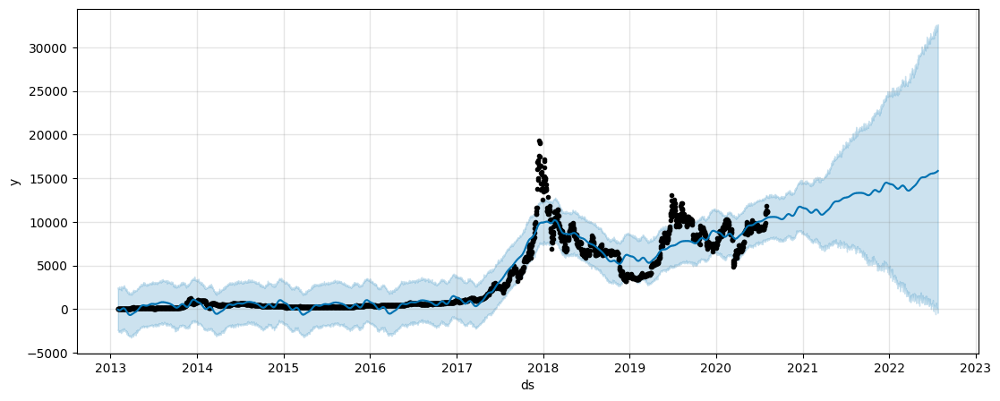

In [16]:
# Se grafican las predicciones (línea) y la base de entranamiento (puntos)
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(13)
fig = m.plot(forecast,ax=ax)
plt.show()

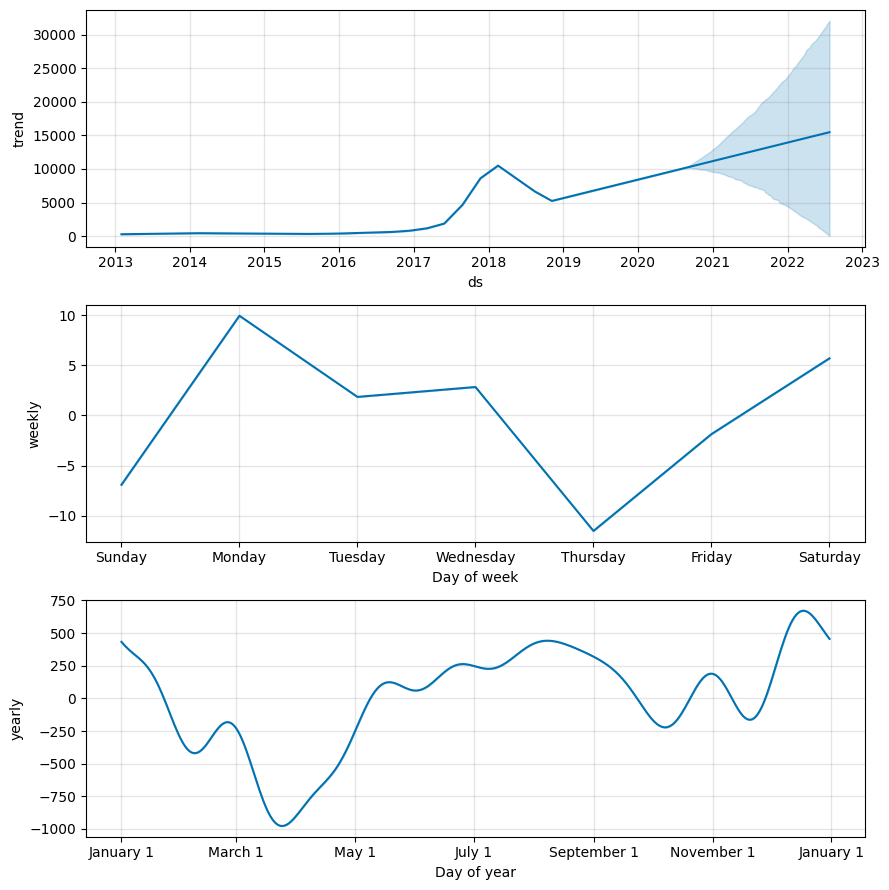

In [17]:
# Se grafican las componenestes de las predicciones
fig2 = m.plot_components(forecast)

Se puede observar que a partir de 2018 comenzo una creciente  adopción del BTC para luego dar comienzo a un periodo bajista. En el 2019 inicio luego del halving el nuevo bullrun. 

In [18]:
# Configuración para obtener gráficos interactivos
from plotly.offline import iplot, init_notebook_mode
import plotly.graph_objs as go

In [19]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

In [20]:
from prophet.plot import plot_plotly, plot_components_plotly

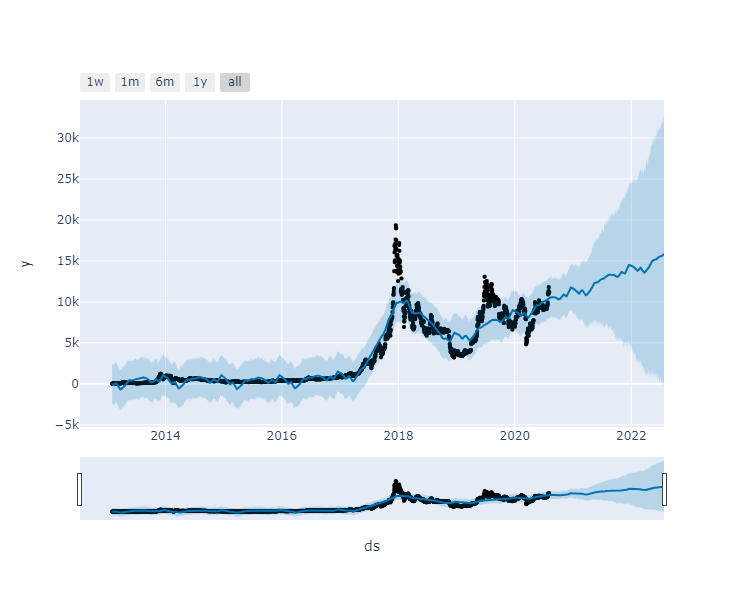

In [21]:
#import plotly.express as px
configure_plotly_browser_state()
init_notebook_mode(connected=False)
fig = plot_plotly(m, forecast) # Replace with your own data
fig.show()

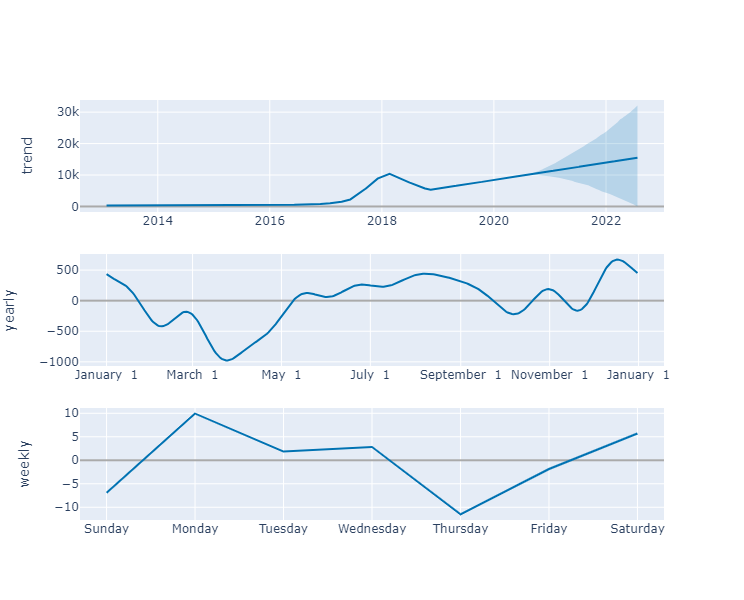

In [22]:
# Se grafican las componentes de las predicciones
configure_plotly_browser_state()
init_notebook_mode(connected=False)
fig = plot_components_plotly(m, forecast)
fig.show()


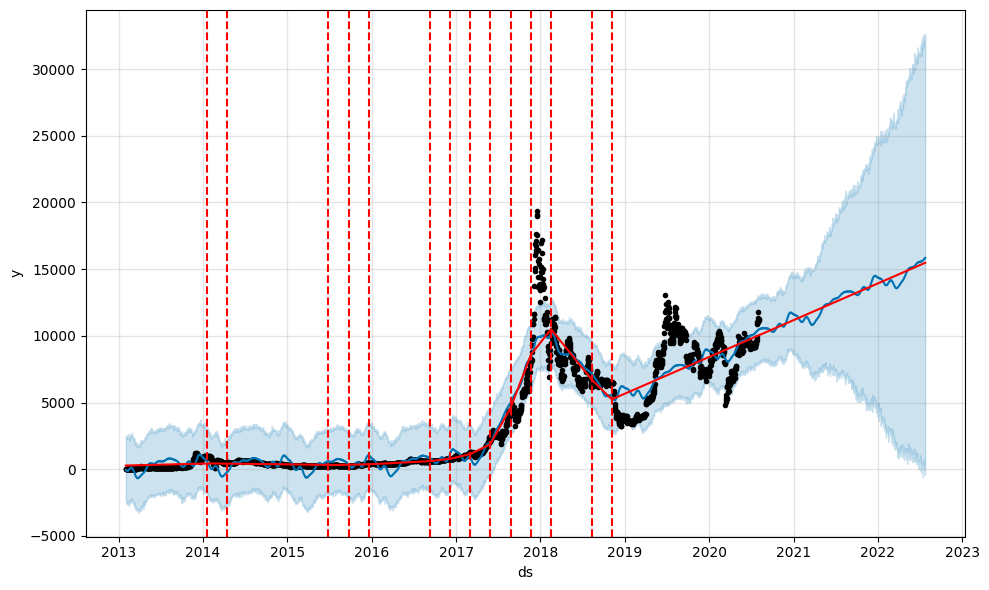

In [23]:
# Se grafican los puntos de cambio
fig = m.plot(forecast)
a = add_changepoints_to_plot(fig.gca(), m, forecast)

Se puede visualizar varios periodos de vertiginosos cambios en la tendencia alcista. Principalmenteel que dio inicio al bear market del 2018.

In [24]:
m.changepoints

88     2013-04-30
175    2013-07-26
263    2013-10-22
351    2014-01-18
438    2014-04-15
526    2014-07-12
614    2014-10-08
701    2015-01-03
789    2015-04-01
877    2015-06-28
964    2015-09-23
1052   2015-12-20
1140   2016-03-17
1228   2016-06-13
1315   2016-09-08
1403   2016-12-05
1491   2017-03-03
1578   2017-05-29
1666   2017-08-25
1754   2017-11-21
1841   2018-02-16
1929   2018-05-15
2017   2018-08-11
2104   2018-11-06
2192   2019-02-02
Name: ds, dtype: datetime64[ns]

In [25]:
m1 = Prophet(interval_width=0.95)
# Restablece el índice para que Prophet pueda utilizar la fecha directamente
test_reset = test.reset_index()

# Renombra las columnas si es necesario
test_reset = test_reset.rename(columns={'Fecha': 'ds', 'Precio': 'y'})

m1.fit(test_reset)
# Se generan las predicciones para la base de testeo
X_tst_forecast = m1.predict(test_reset)
X_tst_forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

20:00:54 - cmdstanpy - INFO - Chain [1] start processing
20:00:55 - cmdstanpy - INFO - Chain [1] done processing


,ds,yhat,yhat_lower,yhat_upper
1171,2023-10-20,30600.670856,25037.218757,35736.978719
1172,2023-10-21,30805.385209,25574.944408,36203.549387
1173,2023-10-22,31009.843992,25438.634037,36839.656153
1174,2023-10-23,31174.104201,25285.595567,36390.455104
1175,2023-10-24,31335.770360,26002.448301,36576.593891


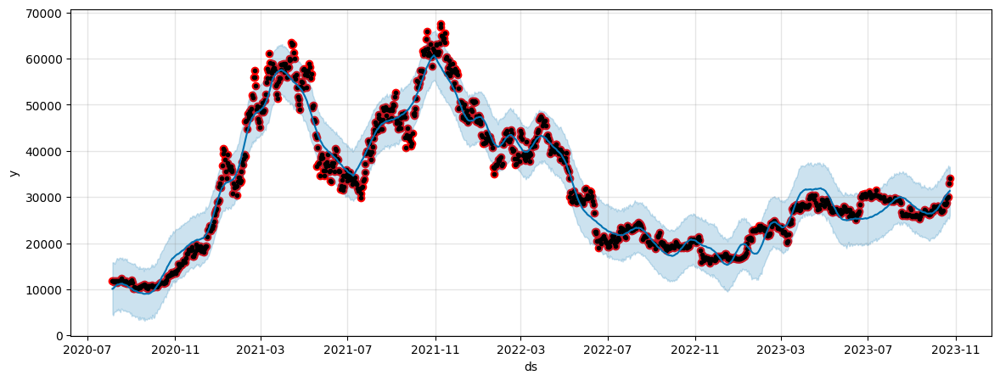

In [26]:
# Se grafican la base de entrenamiento (punteado negro), la de testeo (punteado rojo) y las predicciones (azul)
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(14)
ax.scatter(test_reset.ds, test_reset['y'], color='r')
fig = m1.plot(X_tst_forecast, ax=ax)

In [37]:
test_reset = test_reset.sort_values(by='ds')

In [38]:
# Cálculo de las medidas de precisión
rmse = sqrt(mean_squared_error(test_reset['y'], X_tst_forecast['yhat']))
print('Test RMSE: %.3f' % rmse)
mse = mean_squared_error(test_reset['y'], X_tst_forecast['yhat'])
print('Test MSE: %.3f' % mse)
mae = mean_absolute_error(test_reset['y'], X_tst_forecast['yhat'])
print('Test MAE: %.3f' % mae)
r2 = r2_score(test_reset['y'], X_tst_forecast['yhat'])
print('Test R2: %.3f' % r2)

Test RMSE: 2821.063
Test MSE: 7958396.171
Test MAE: 2193.182
Test R2: 0.958


En este caso el R2 de 0.958 indica un modelo que ajusta a la variabilidad de los datos. 

In [40]:

m2 = Prophet(interval_width=0.95)

train1_reset = train1.reset_index()


train1_reset = train1_reset.rename(columns={'Fecha': 'ds', 'Precio1': 'y'})

# Ajusta el modelo con los datos de entrenamiento
m2.fit(train1_reset)

# Crea un DataFrame de fechas futuras para hacer predicciones
future1 = m2.make_future_dataframe(periods=720, freq='D')

# Genera las predicciones
forecast1 = m2.predict(future1)

# Muestra las últimas filas de las predicciones, incluyendo la columna 'ds' y la columna 'yhat'
print(forecast1[['ds', 'yhat']].tail())

train1_reset.info()

20:10:14 - cmdstanpy - INFO - Chain [1] start processing
20:10:15 - cmdstanpy - INFO - Chain [1] done processing


             ds       yhat
2620 2022-08-07  49.471821
2621 2022-08-08  49.942391
2622 2022-08-09  49.875561
2623 2022-08-10  50.017989
2624 2022-08-11  50.249155
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1905 entries, 0 to 1904
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      1905 non-null   datetime64[ns]
 1   y       1905 non-null   float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 29.9 KB


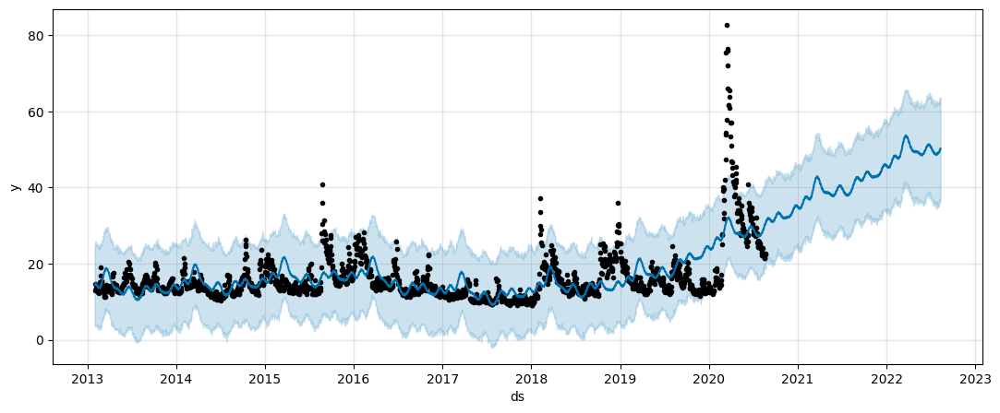

In [41]:
# Se grafican las predicciones (línea) y la base de entranamiento (puntos)
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(13)
fig = m2.plot(forecast1,ax=ax)
plt.show()

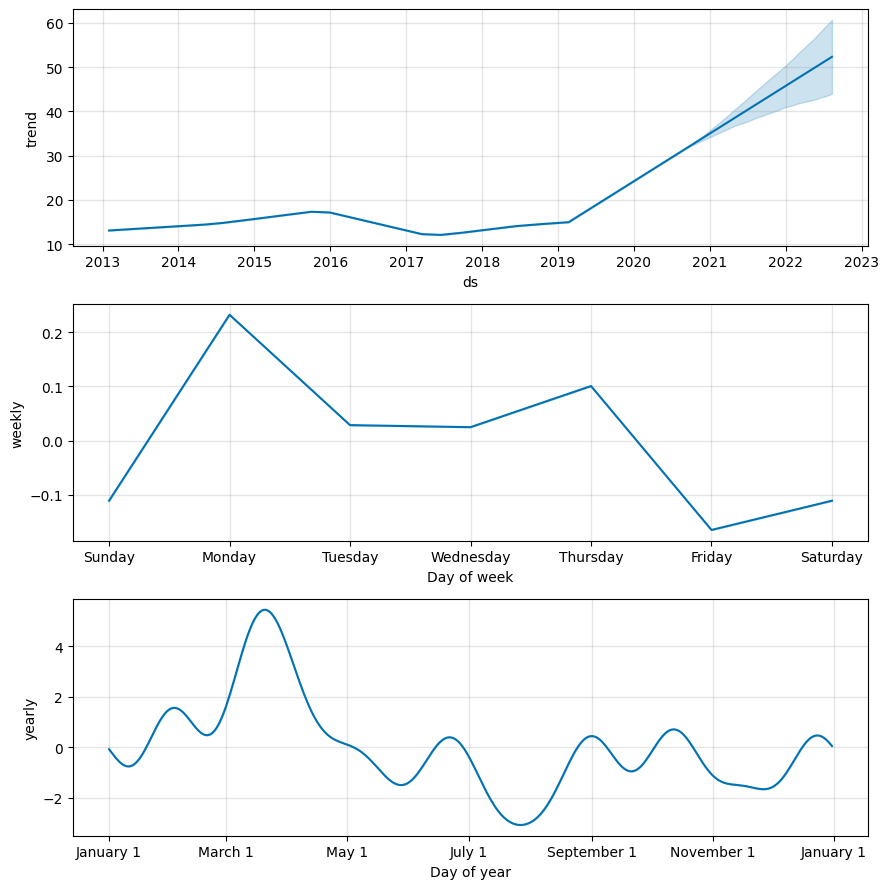

In [42]:
# Se grafican las componenestes de las predicciones
fig2 = m2.plot_components(forecast1)

Observamos una tendencia alcista en la volatilidad del mercado a partir del 2019 , debemos atribuir esto en mayor medida a la pandemia.

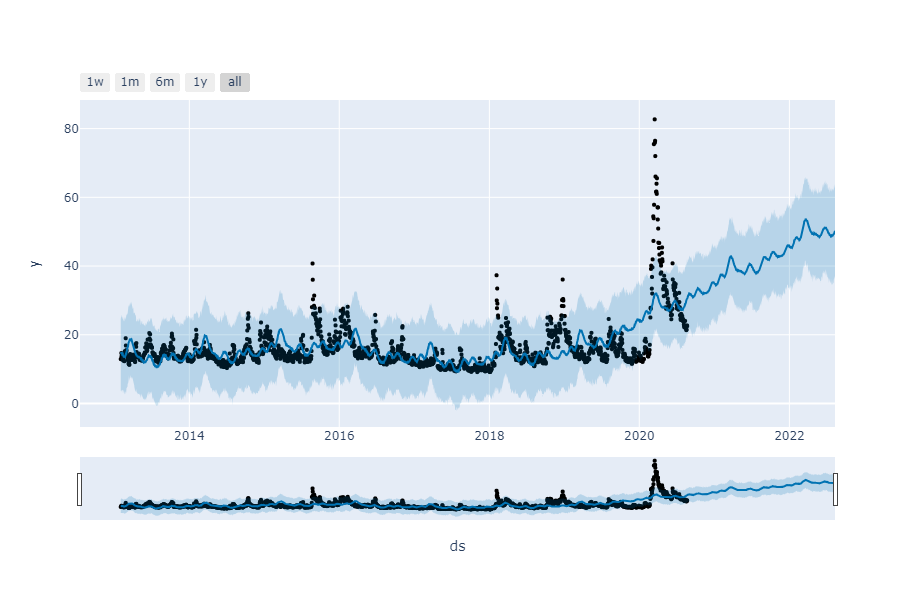

In [43]:
#import plotly.express as px
configure_plotly_browser_state()
init_notebook_mode(connected=False)
fig = plot_plotly(m2, forecast1) # Replace with your own data
fig.show()

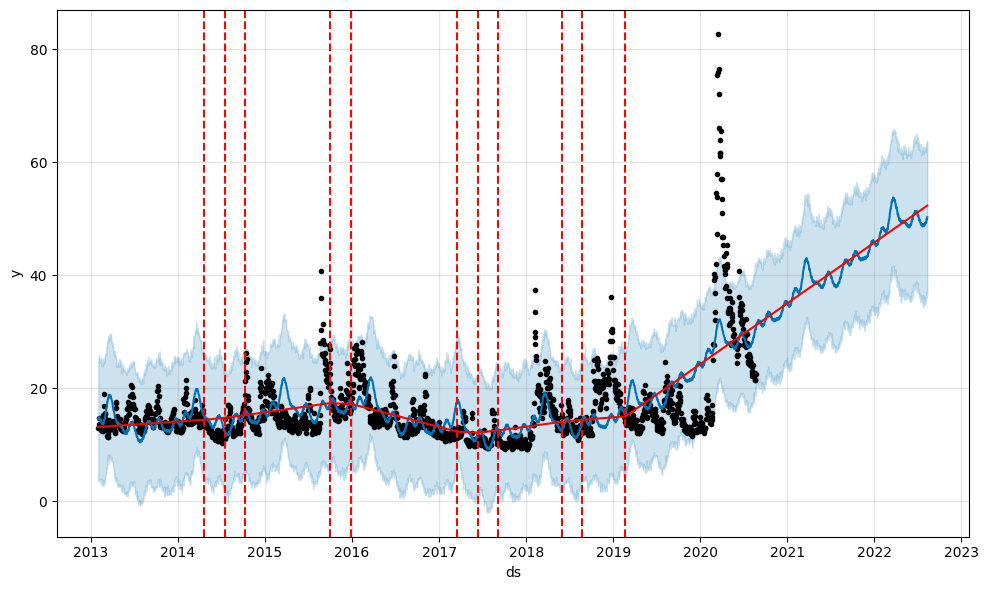

In [44]:
# Se grafican los puntos de cambio
fig = m2.plot(forecast1)
a = add_changepoints_to_plot(fig.gca(),m2, forecast1)

In [45]:
m2.changepoints

61     2013-05-01
122    2013-07-29
183    2013-10-23
244    2014-01-22
305    2014-04-21
366    2014-07-17
426    2014-10-10
487    2015-01-08
548    2015-04-08
609    2015-07-06
670    2015-09-30
731    2015-12-28
792    2016-03-28
853    2016-06-22
914    2016-09-19
975    2016-12-14
1036   2017-03-15
1097   2017-06-12
1157   2017-09-06
1218   2017-12-01
1279   2018-03-02
1340   2018-05-30
1401   2018-08-24
1462   2018-11-20
1523   2019-02-21
Name: ds, dtype: datetime64[ns]

In [46]:
m3 = Prophet(interval_width=0.95)
test1_reset = test1.reset_index()
test1_reset = test1_reset.rename(columns={'Fecha': 'ds', 'Precio1': 'y'})

m3.fit(test1_reset)
# Se generan las predicciones para la base de testeo
X_tst_forecast1 = m3.predict(test1_reset)
X_tst_forecast1[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


20:10:35 - cmdstanpy - INFO - Chain [1] start processing
20:10:35 - cmdstanpy - INFO - Chain [1] done processing


,ds,yhat,yhat_lower,yhat_upper
812,2023-10-18,16.985511,11.952440,22.750241
813,2023-10-19,16.937082,11.420075,21.996929
814,2023-10-20,16.573551,11.171455,21.460831
815,2023-10-23,16.723686,11.503876,21.954547
816,2023-10-24,16.659322,11.565018,22.381016


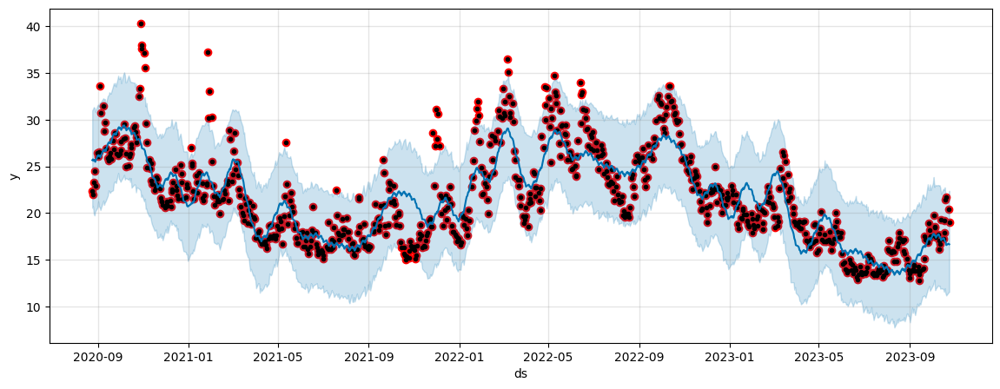

In [47]:
# Se grafican la base de entrenamiento (punteado negro), la de testeo (punteado rojo) y las predicciones (azul)
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(14)
ax.scatter(test1_reset.ds, test1_reset['y'], color='r')
fig = m3.plot(X_tst_forecast1, ax=ax)

In [51]:
test1_reset = test1_reset.sort_values(by='ds')

In [52]:
# Cálculo de las medidas de precisión
rmse = sqrt(mean_squared_error(test1_reset['y'], X_tst_forecast1['yhat']))
print('Test RMSE: %.3f' % rmse)
mse = mean_squared_error(test1_reset['y'], X_tst_forecast1['yhat'])
print('Test MSE: %.3f' % mse)
mae = mean_absolute_error(test1_reset['y'], X_tst_forecast1['yhat'])
print('Test MAE: %.3f' % mae)
r2 = r2_score(test1_reset['y'], X_tst_forecast1['yhat'])
print('Test R2: %.3f' % r2)

Test RMSE: 2.760
Test MSE: 7.616
Test MAE: 2.059
Test R2: 0.713


En este caso un R2 0.713 lo cual implica que este modelo ajusta mucho menos respecto al modelo del BTC

In [53]:
m4 = Prophet(interval_width=0.95)

train2_reset = train2.reset_index()


train2_reset = train2_reset.rename(columns={'Fecha': 'ds', 'Precio2': 'y'})

# Ajusta el modelo con los datos de entrenamiento
m4.fit(train2_reset)

# Crea un DataFrame de fechas futuras para hacer predicciones
future2 = m4.make_future_dataframe(periods=720, freq='D')

# Genera las predicciones
forecast2 = m4.predict(future2)

# Muestra las últimas filas de las predicciones, incluyendo la columna 'ds' y la columna 'yhat'
print(forecast2[['ds', 'yhat']].tail())

train2_reset.info()

20:16:25 - cmdstanpy - INFO - Chain [1] start processing
20:16:26 - cmdstanpy - INFO - Chain [1] done processing


             ds        yhat
2609 2022-07-27  361.264855
2610 2022-07-28  361.287693
2611 2022-07-29  361.145453
2612 2022-07-30  359.899224
2613 2022-07-31  359.777099
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1894 entries, 0 to 1893
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      1894 non-null   datetime64[ns]
 1   y       1894 non-null   float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 29.7 KB


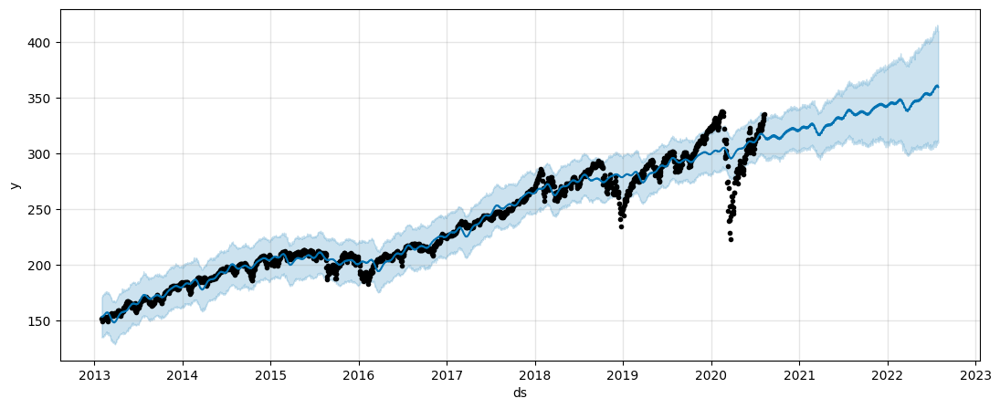

In [54]:
# Se grafican las predicciones (línea) y la base de entranamiento (puntos)
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(13)
fig = m4.plot(forecast2,ax=ax)
plt.show()

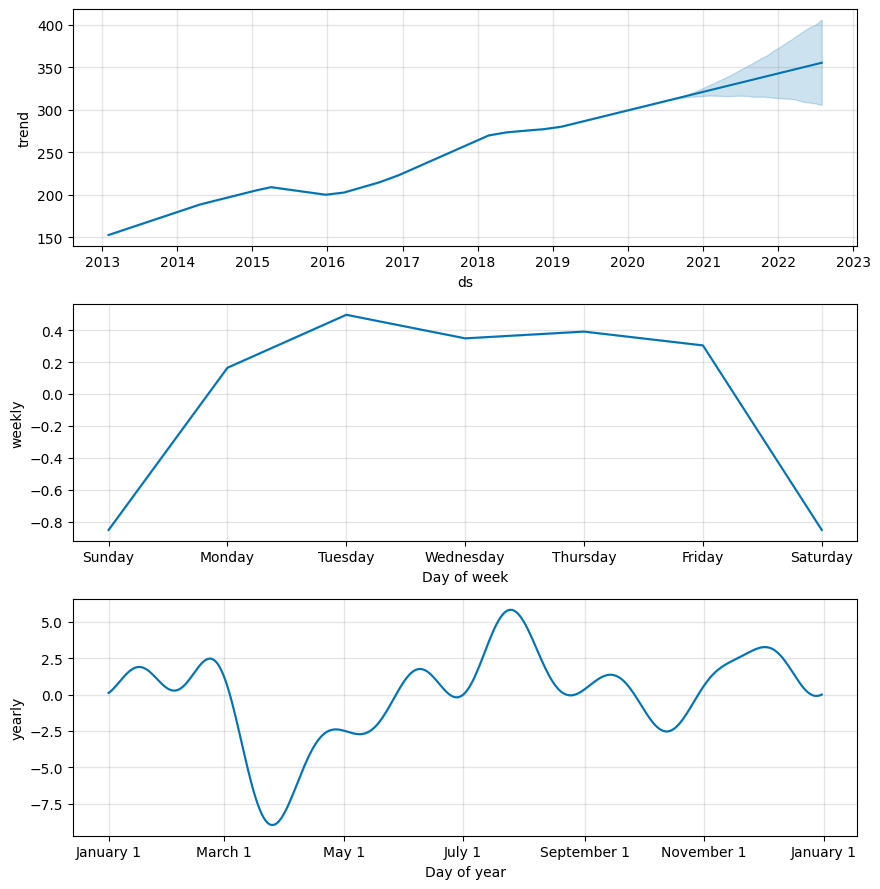

In [55]:
# Se grafican las componenestes de las predicciones
fig2 = m4.plot_components(forecast2)

A partir del 2013 podemos visualizar una tendencia alcista del SPY, la misma parece que no se ve afectada por la pandemia.

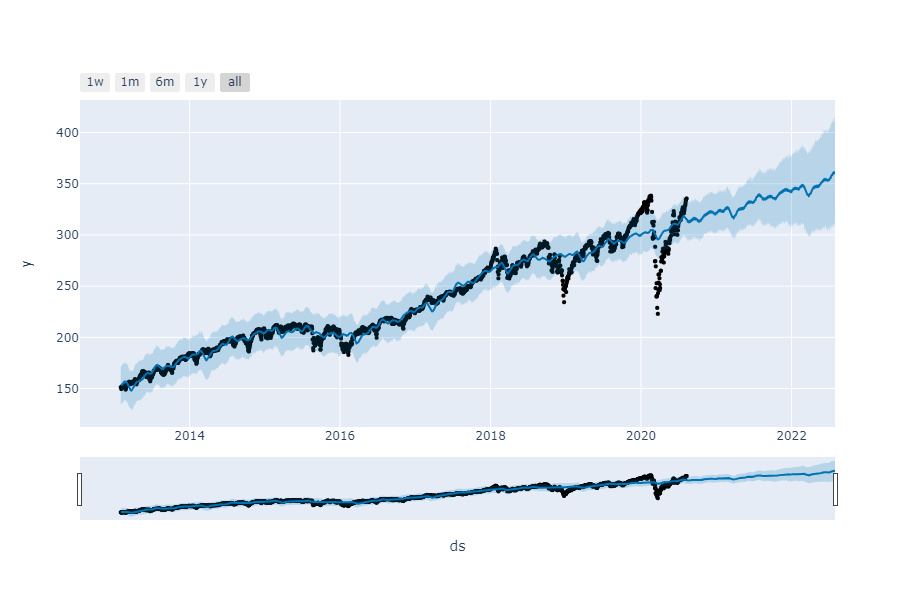

In [56]:
#import plotly.express as px
configure_plotly_browser_state()
init_notebook_mode(connected=False)
fig = plot_plotly(m4, forecast2) # Replace with your own data
fig.show()

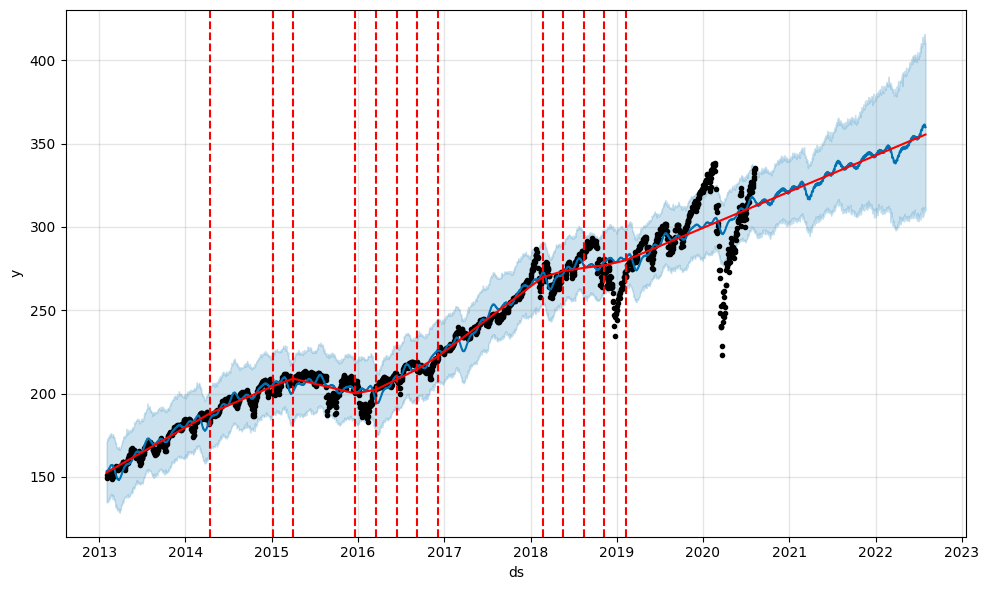

In [57]:
# Se grafican los puntos de cambio
fig = m4.plot(forecast2)
a = add_changepoints_to_plot(fig.gca(), m4, forecast2)

In [58]:
m4.changepoints

61     2013-05-01
121    2013-07-26
182    2013-10-22
242    2014-01-17
303    2014-04-16
363    2014-07-14
424    2014-10-08
484    2015-01-05
545    2015-04-02
606    2015-06-30
666    2015-09-24
727    2015-12-21
787    2016-03-18
848    2016-06-15
908    2016-09-09
969    2016-12-06
1030   2017-03-07
1090   2017-06-01
1151   2017-08-28
1211   2017-11-21
1272   2018-02-21
1332   2018-05-17
1393   2018-08-14
1453   2018-11-07
1514   2019-02-07
Name: ds, dtype: datetime64[ns]

In [59]:
m4 = Prophet(interval_width=0.95)
test2_reset = test2.reset_index()
test2_reset = test2_reset.rename(columns={'Fecha': 'ds', 'Precio2': 'y'})
test2_reset.info()
m4.fit(test2_reset)
# Se generan las predicciones para la base de testeo
X_tst_forecast2 = m4.predict(test2_reset)
X_tst_forecast2[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


20:16:30 - cmdstanpy - INFO - Chain [1] start processing


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 812 entries, 0 to 811
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      812 non-null    datetime64[ns]
 1   y       812 non-null    float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 12.8 KB


20:16:31 - cmdstanpy - INFO - Chain [1] done processing


,ds,yhat,yhat_lower,yhat_upper
807,2023-10-18,434.463739,417.928326,450.836383
808,2023-10-19,435.119787,417.776562,450.332132
809,2023-10-20,435.788974,418.672016,451.244081
810,2023-10-23,437.741053,420.970006,452.514119
811,2023-10-24,437.808596,421.826202,453.348695


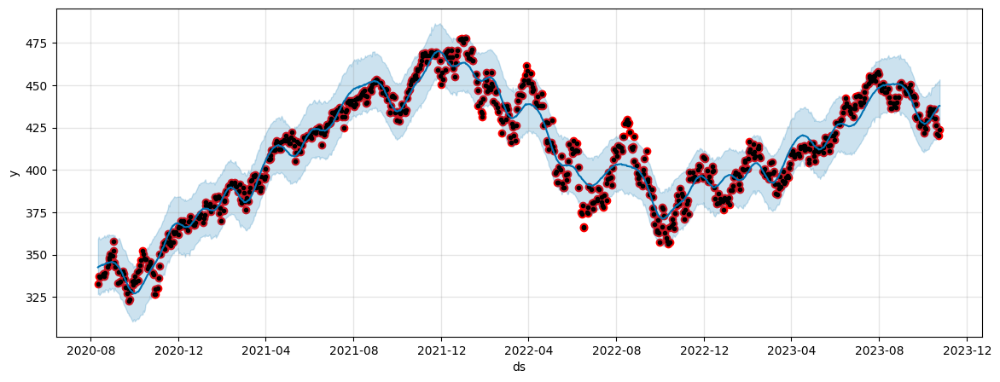

In [60]:
# Se grafican la base de entrenamiento (punteado negro), la de testeo (punteado rojo) y las predicciones (azul)
f, ax = plt.subplots(1)
f.set_figheight(5)
f.set_figwidth(14)
ax.scatter(test2_reset.ds, test2_reset['y'], color='r')
fig = m4.plot(X_tst_forecast2, ax=ax)

In [62]:
test2_reset = test2_reset.sort_values(by='ds')

In [63]:
# Cálculo de las medidas de precisión
rmse = sqrt(mean_squared_error(test2_reset['y'], X_tst_forecast2['yhat']))
print('Test RMSE: %.3f' % rmse)
mse = mean_squared_error(test2_reset['y'], X_tst_forecast2['yhat'])
print('Test MSE: %.3f' % mse)
mae = mean_absolute_error(test2_reset['y'], X_tst_forecast2['yhat'])
print('Test MAE: %.3f' % mae)
r2 = r2_score(test2_reset['y'], X_tst_forecast2['yhat'])
print('Test R2: %.3f' % r2)

Test RMSE: 8.261
Test MSE: 68.252
Test MAE: 6.520
Test R2: 0.944


En este caso al igual del BTC, el R2 indica un ajuste de 0.944 lo cual se puede observar un buen nivel de ajuste de datos.